# **Spatial-temporal analysis of surface water quality parameters using satellite imagery.**
---
**TEAM: GeoRaZu – Raghavendra S P, Zubair Ahmed **


In [ ]:
%%capture
!pip install pystac_client
!pip install rioxarray
!pip install geopandas
!pip install stackstac

In [ ]:
import rioxarray
import xarray
import pystac_client
from shapely.geometry import Point
from geopandas import GeoDataFrame
from pandas import DataFrame
import geopandas as gpd
from rasterio.enums import Resampling
import numpy as np
import stackstac
import folium
import matplotlib
import matplotlib.pyplot as plt
from rasterio.features import rasterize

In [ ]:
date_range = '2019-03-01/2023-03-01' # YYYY-MM-DD
collection_name = "sentinel-s2-l2a-cogs" # msi level-2A
clou_cover = 'eo:cloud_cover<=10' # percentage of cloud cover
data_coverage = "sentinel:data_coverage>80"

In [ ]:
api_url = "https://earth-search.aws.element84.com/v0"
client = pystac_client.Client.open(api_url)
point = Point( 77.40283459638486,12.506726842896839)

In [ ]:
search = client.search(
    query=[clou_cover,data_coverage],
    collections=[collection_name],
    # bbox=bounds,
    intersects=point,
    datetime=date_range,
    sortby= ['properties.eo:cloud_cover'],
)

In [ ]:
# get all items
items_dict = [i.to_dict() for i in search.get_items()]
print(f"{len(items_dict)} scenes fetched")

72 scenes fetched


In [ ]:
stack = stackstac.stack(items_dict,fill_value=0, dtype="uint16",resolution=10,resampling=Resampling.lanczos)
crs = stack.attrs['crs']
stack

<xarray.DataArray 'stackstac-18b6642834aa27c59f07e92d3aaa8731' (time: 72,
                                                                band: 17,
                                                                y: 10980,
                                                                x: 10980)>
dask.array<fetch_raster_window, shape=(72, 17, 10980, 10980), dtype=uint16, chunksize=(1, 1, 1024, 1024), chunktype=numpy.ndarray>
Coordinates: (12/29)
  * time                          (time) datetime64[ns] 2019-03-10T05:35:51 ....
    id                            (time) <U24 'S2B_43PGP_20190310_0_L2A' ... ...
  * band                          (band) <U8 'overview' 'B11' ... 'visual' 'SCL'
  * x                             (x) float64 7e+05 7e+05 ... 8.098e+05
  * y                             (y) float64 1.4e+06 1.4e+06 ... 1.29e+06
    sentinel:product_id           (time) <U60 'S2B_MSIL2A_20190310T050649_N02...
    ...                            ...
    sentinel:boa_offset_applied   (time) object None None None ... True True
    title                         (band) <U31 'True color image' ... 'Scene C...
    common_name                   (band) object None 'swir16' ... None None
    center_wavelength             (band) object None 1.6137 0.4439 ... None None
    full_width_half_max           (band) object None 0.143 0.027 ... None None
    epsg                          int64 32643
Attributes:
    spec:        RasterSpec(epsg=32643, bounds=(699960, 1290240, 809760, 1400...
    crs:         epsg:32643
    transform:   | 10.00, 0.00, 699960.00|\n| 0.00,-10.00, 1400040.00|\n| 0.0...
    resolution:  10

In [ ]:
ds = xarray.Dataset()

In [ ]:
ds['B01']=stack.sel(band='B01')
ds['B02']=stack.sel(band='B02')
ds['B03']=stack.sel(band='B03')
ds['B04']=stack.sel(band='B04')
ds['B05']=stack.sel(band='B05')
ds['B06']=stack.sel(band='B06')
ds['B07']=stack.sel(band='B07')
ds['B08']=stack.sel(band='B08')
ds['B09']=stack.sel(band='B09')
ds['B11']=stack.sel(band='B11')
ds['B12']=stack.sel(band='B12')

In [ ]:
ds = ds.reset_coords(drop=True)

In [ ]:
def aoi (point,radius,crs):
  gpf = gpd.GeoDataFrame(index=[0], crs='epsg:4326', geometry=[point])
  gpf = gpf.to_crs(crs)
  buffer = gpf.buffer(radius)
  return buffer
aoi1 = aoi(point,15000,crs).total_bounds

In [ ]:
aoi2 = aoi(point,15000,crs).to_crs('epsg:4326').total_bounds

In [ ]:
aoi2

array([77.26489349, 12.3712003 , 77.54076103, 12.64225191])

In [ ]:
cliped = (ds.rio.clip_box(*aoi1)/10000).astype('float32')
cliped

<xarray.Dataset>
Dimensions:      (time: 72, y: 3001, x: 3001)
Coordinates:
  * time         (time) datetime64[ns] 2019-03-10T05:35:51 ... 2023-02-27T05:...
  * x            (x) float64 7.461e+05 7.462e+05 ... 7.761e+05 7.761e+05
  * y            (y) float64 1.399e+06 1.399e+06 ... 1.369e+06 1.369e+06
    spatial_ref  int64 0
Data variables:
    B01          (time, y, x) float32 dask.array<chunksize=(1, 897, 502), meta=np.ndarray>
    B02          (time, y, x) float32 dask.array<chunksize=(1, 897, 502), meta=np.ndarray>
    B03          (time, y, x) float32 dask.array<chunksize=(1, 897, 502), meta=np.ndarray>
    B04          (time, y, x) float32 dask.array<chunksize=(1, 897, 502), meta=np.ndarray>
    B05          (time, y, x) float32 dask.array<chunksize=(1, 897, 502), meta=np.ndarray>
    B06          (time, y, x) float32 dask.array<chunksize=(1, 897, 502), meta=np.ndarray>
    B07          (time, y, x) float32 dask.array<chunksize=(1, 897, 502), meta=np.ndarray>
    B08          (time, y, x) float32 dask.array<chunksize=(1, 897, 502), meta=np.ndarray>
    B09          (time, y, x) float32 dask.array<chunksize=(1, 897, 502), meta=np.ndarray>
    B11          (time, y, x) float32 dask.array<chunksize=(1, 897, 502), meta=np.ndarray>
    B12          (time, y, x) float32 dask.array<chunksize=(1, 897, 502), meta=np.ndarray>

In [ ]:
def plot_f(dataArray,time=None):
  if dataArray.shape[0]==1:
    plot = dataArray.plot(col=time,cmap ='bone',size=8 , robust=True)
  else:
    plot = dataArray.plot.imshow(col=time,size=8 , robust=True)

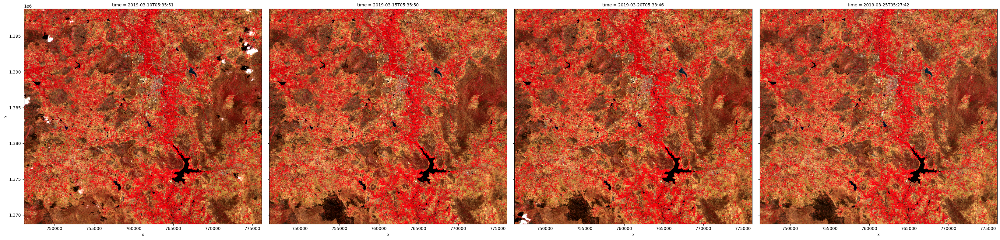

In [ ]:
plot_f(cliped[['B08','B04','B03']].isel(time=[0,1,2,3]).to_array(),time='time')

In [ ]:
def ndwi_f(dataArray):
  index = (dataArray['B03']-dataArray['B08'])/(dataArray['B03']+dataArray['B08'])
  return index

def mndwi_f(dataArray):
  index = (dataArray['B03']-dataArray['B11'])/(dataArray['B03']+dataArray['B11'])
  return index


In [ ]:
cliped['ndwi']=ndwi_f(cliped)
cliped['mndwi']=mndwi_f(cliped)

In [ ]:
def ndti_f(dataArray):
  index = (dataArray['B04']-dataArray['B03'])/(dataArray['B03']+dataArray['B04'])
  return index

def calc_turbidity_ntu(dataArray):
  turbidity_ntu = ((dataArray['B04'])-0.014)/0.013
  return turbidity_ntu

def ndsi_f(dataArray):
  index = (dataArray['B02']-dataArray['B08'])/(dataArray['B02']+dataArray['B08'])
  return index

def chlorphyll_f(dataArray):
  index = ((dataArray['B05'])/(dataArray['B04'])-1.1032)/0.1072
  return index

def ph_f(dataArray):
  index = (5.50287716864829 + 0.000268672118928222 * (dataArray['ndwi']*10000) + 4.01403093541076e-6 * (dataArray['mndwi']*10000) + 5.48809801030712e-8 * ((dataArray['mndwi']*10000) * (dataArray['mndwi']*10000)) + 0.397031729312931 * np.sin(5.29331388964706 + 5.50287716864829 * (dataArray['mndwi']*10000)) - 0.358918009632248 * np.sin(2.5021754207847 * (dataArray['mndwi']*10000)))
  return index

In [ ]:
cliped['ndti']= ndti_f(cliped)
cliped['NDSSI']= ndsi_f(cliped)
cliped['ndci']= chlorphyll_f(cliped)
cliped['tur_ntu']= calc_turbidity_ntu(cliped)
cliped['ph']= ph_f(cliped)

In [ ]:
samples =  gpd.read_file('/content/poly_sam.geojson').to_crs(crs)

In [ ]:
river = samples[samples['type']==1]
reservior = samples[samples['type']==2]

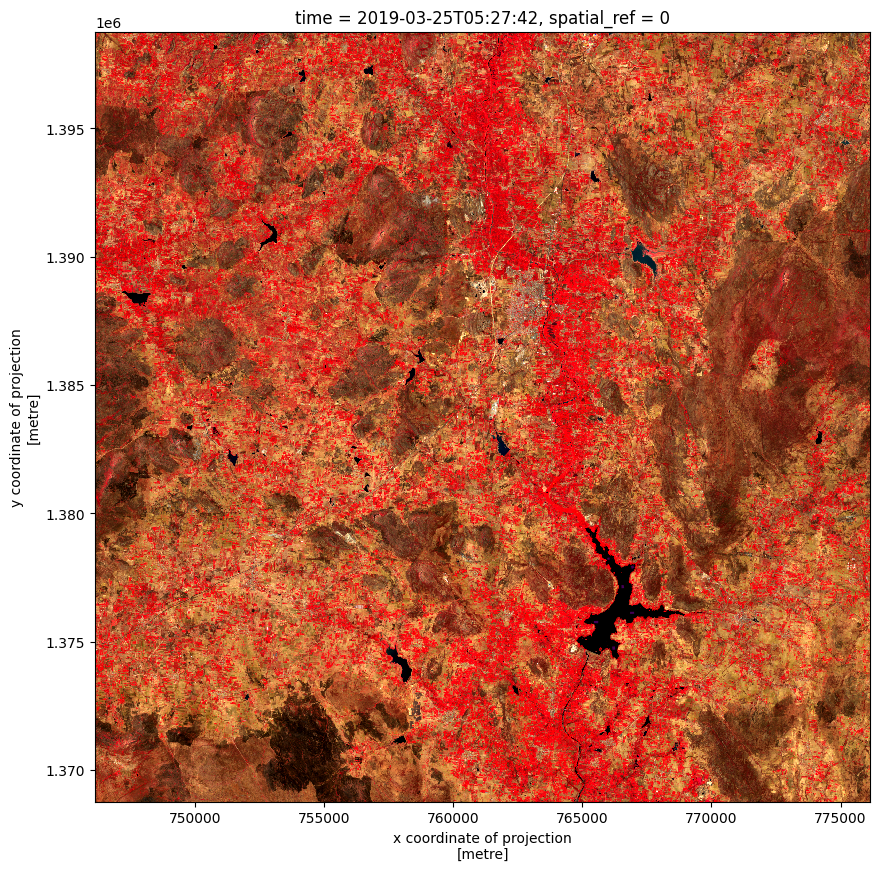

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
samples.plot( column='type',ax=ax, legend=False)
cliped[['B08','B04','B03']].isel(time=3).to_array().plot.imshow(ax=ax,robust=True)

In [ ]:
river_ts = cliped.rio.clip(river.geometry.values)
reservior_ts = cliped.rio.clip(reservior.geometry.values)

/usr/local/lib/python3.10/dist-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))


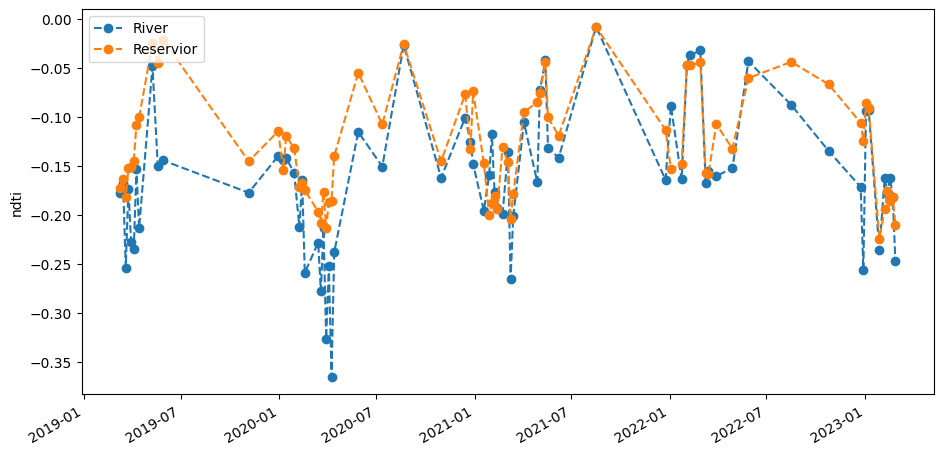

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(11, 5))
river_ts['ndti'].mean(['x','y']).plot(ax=ax, label='River', linestyle='dashed', marker='o')
reservior_ts['ndti'].mean(['x','y']).plot(ax=ax, label='Reservior', linestyle='dashed', marker='o')
plt.legend(loc="lower left")
plt.title("")
plt.xlabel("")

Text(0.5, 0, '')

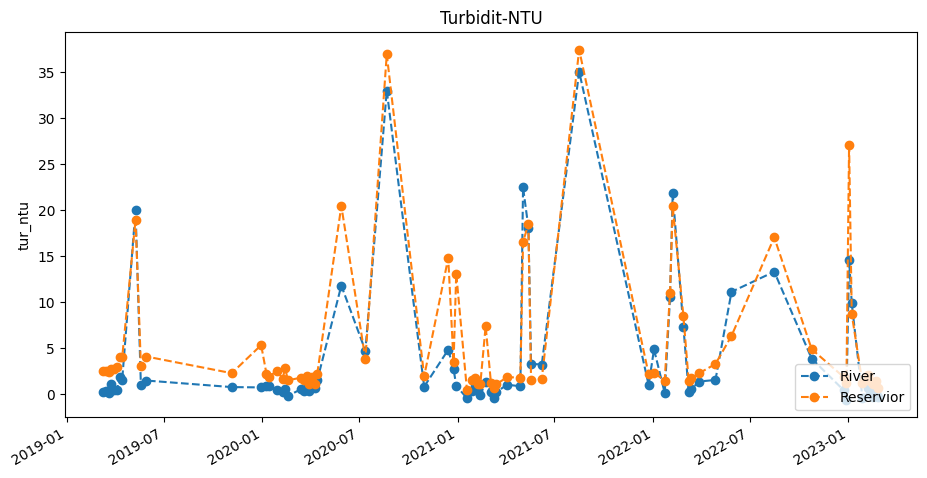

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(11, 5))
river_ts['tur_ntu'].mean(['x','y']).plot(ax=ax, label='River', linestyle='dashed', marker='o')
reservior_ts['tur_ntu'].mean(['x','y']).plot(ax=ax, label='Reservior', linestyle='dashed', marker='o')
plt.legend(loc="top right")
plt.title("Turbidity-NTU")
plt.xlabel("")

/usr/local/lib/python3.10/dist-packages/dask/core.py:119: RuntimeWarning: divide by zero encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))
/usr/local/lib/python3.10/dist-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))


Text(0.5, 0, '')

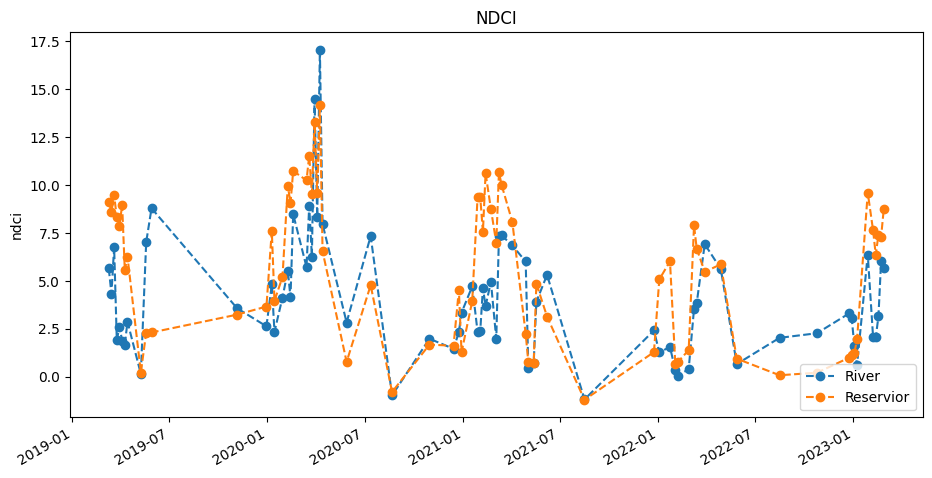

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(11, 5))
river_ts['ndci'].mean(['x','y']).plot(ax=ax, label='River', linestyle='dashed', marker='o')
reservior_ts['ndci'].mean(['x','y']).plot(ax=ax, label='Reservior', linestyle='dashed', marker='o')
plt.legend(loc="lower right")
plt.title("NDCI")
plt.xlabel("")

/usr/local/lib/python3.10/dist-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))


Text(0.5, 0, '')

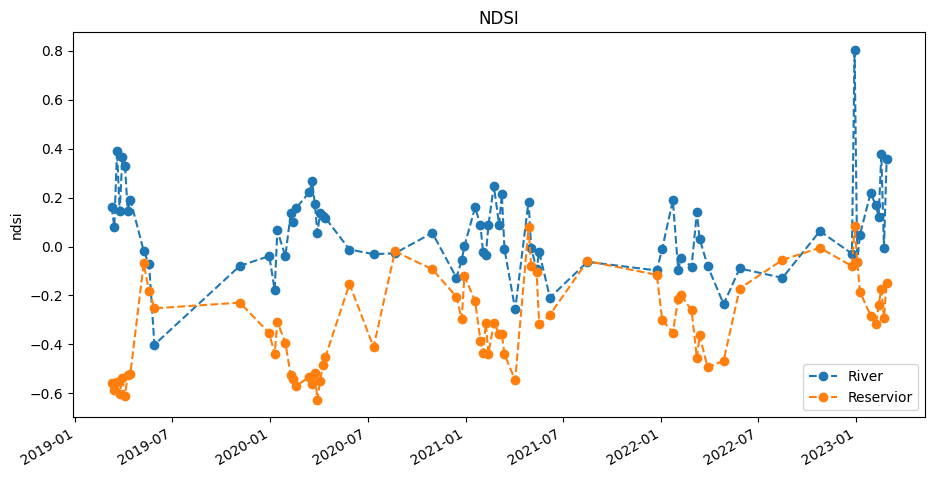

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(11, 5))
river_ts['NDSSI'].mean(['x','y']).plot(ax=ax, label='River', linestyle='dashed', marker='o')
reservior_ts['ndsi'].mean(['x','y']).plot(ax=ax, label='Reservior', linestyle='dashed', marker='o')
plt.legend(loc="lower right")
plt.title("NDSSI")
plt.xlabel("")

/usr/local/lib/python3.10/dist-packages/dask/core.py:119: RuntimeWarning: invalid value encountered in true_divide
  return func(*(_execute_task(a, cache) for a in args))


Text(0.5, 0, '')

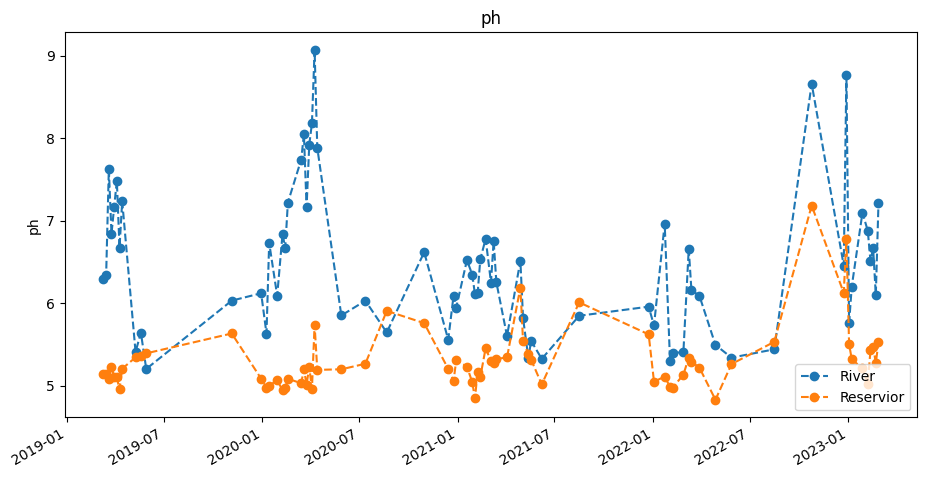

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(11, 5))
river_ts['ph'].mean(['x','y']).plot(ax=ax, label='River', linestyle='dashed', marker='o')
reservior_ts['ph'].mean(['x','y']).plot(ax=ax, label='Reservior', linestyle='dashed', marker='o')
plt.legend(loc="lower right")
plt.title("ph")
plt.xlabel("")

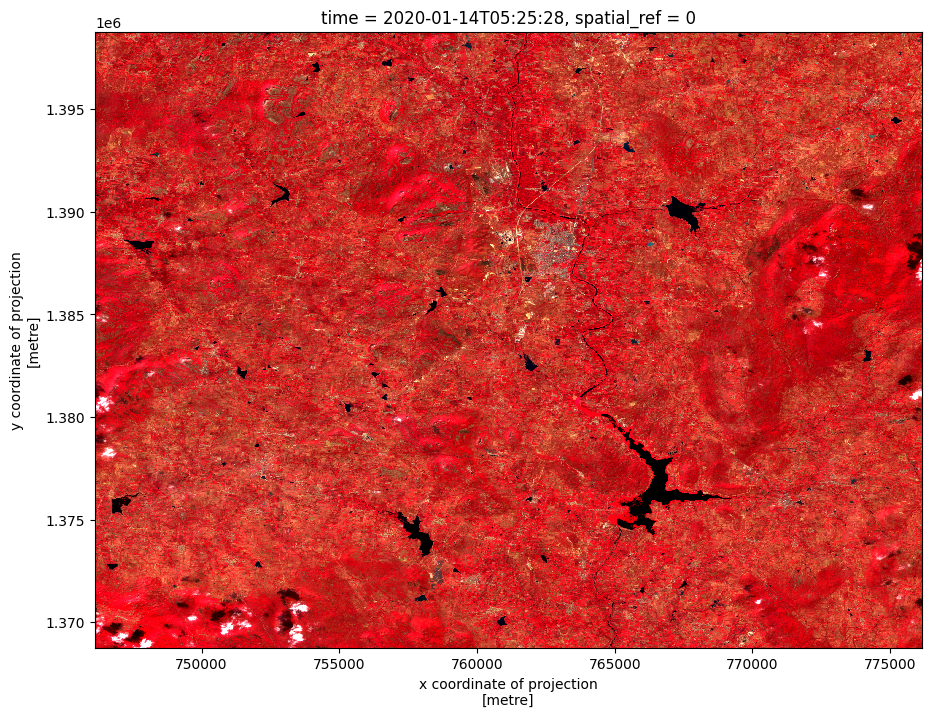

In [ ]:
plot_f(cliped[['B08','B04','B03']].sel(time='2020-01-14T05:25:28.000000000').to_array())

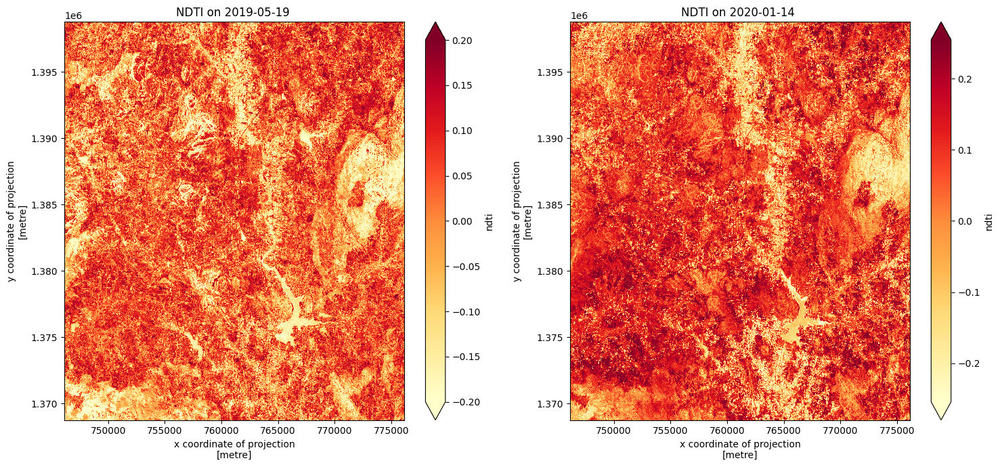

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(15, 7))
cliped['ndti'].sel(time='2019-05-19T05:25:42.000000000').plot(cmap='YlOrRd',ax=ax[1],robust=True)
cliped['ndti'].sel(time='2020-01-14T05:25:28.000000000').plot(cmap='YlOrRd',ax=ax[0],vmin=-0.2,vmax=0.2)
ax[0].set(title='NDTI on 2019-05-19')
ax[1].set(title='NDTI on 2020-01-14')
plt.tight_layout()

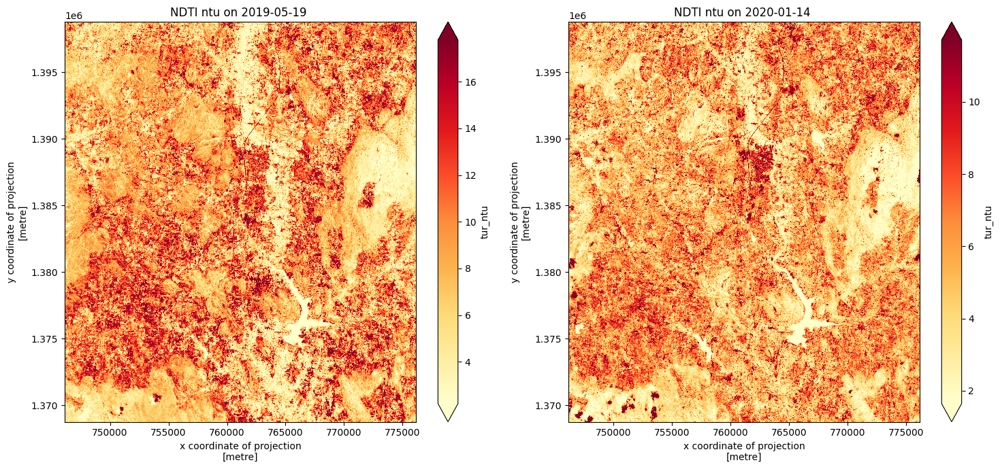

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(15,7))
cliped['tur_ntu'].sel(time='2019-05-19T05:25:42.000000000').plot(cmap='YlOrRd',ax=ax[0],robust=True)
cliped['tur_ntu'].sel(time='2020-01-14T05:25:28.000000000').plot(cmap='YlOrRd',robust=True)
ax[0].set(title='NDTI ntu on 2019-05-19 ')
ax[1].set(title='NDTI ntu on 2020-01-14 ')
plt.tight_layout()

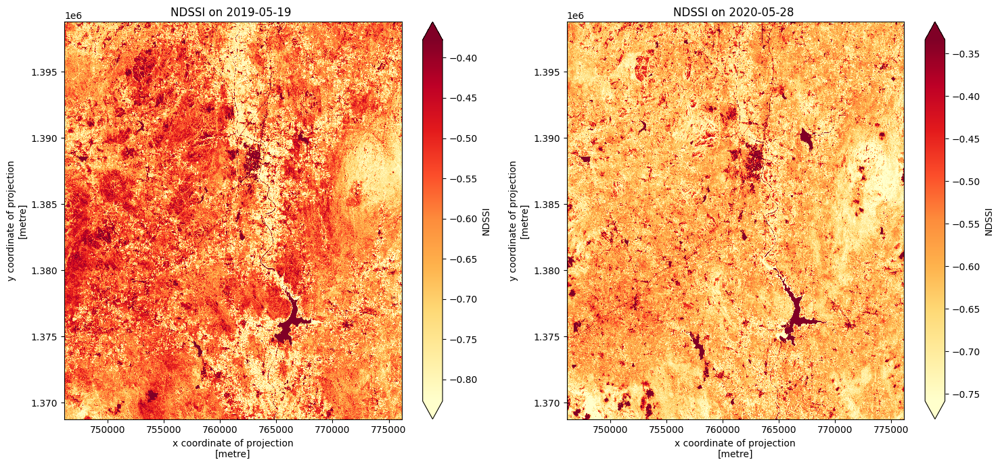

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(15, 7))
cliped['NDSSI'].sel(time='2019-05-19T05:25:42.000000000').plot(cmap='YlOrRd',ax=ax[0],robust=True)
cliped['NDSSI'].sel(time='2020-01-14T05:25:28.000000000').plot(cmap='YlOrRd',ax=ax[1],robust=True)
ax[0].set(title='NDSSI on 2019-05-19 ')
ax[1].set(title='NDSSI on 2020-05-28 ')
plt.tight_layout()

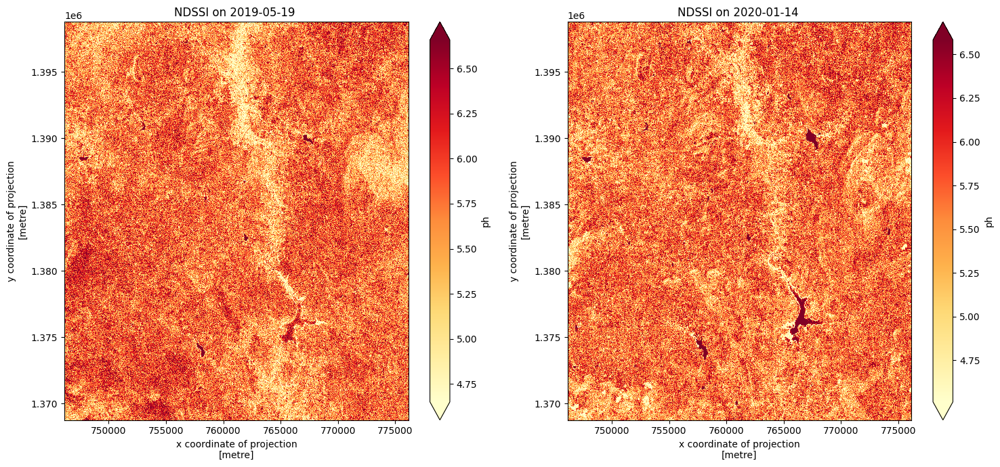

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(15, 7))
cliped['ph'].sel(time='2019-05-19T05:25:42.000000000').plot(cmap='YlOrRd',ax=ax[0],robust=True)
cliped['ph'].sel(time='2020-01-14T05:25:28.000000000').plot(cmap='YlOrRd',ax=ax[1],robust=True)
ax[0].set(title='NDSSI on 2019-05-19')
ax[1].set(title='NDSSI on 2020-01-14')
plt.tight_layout()

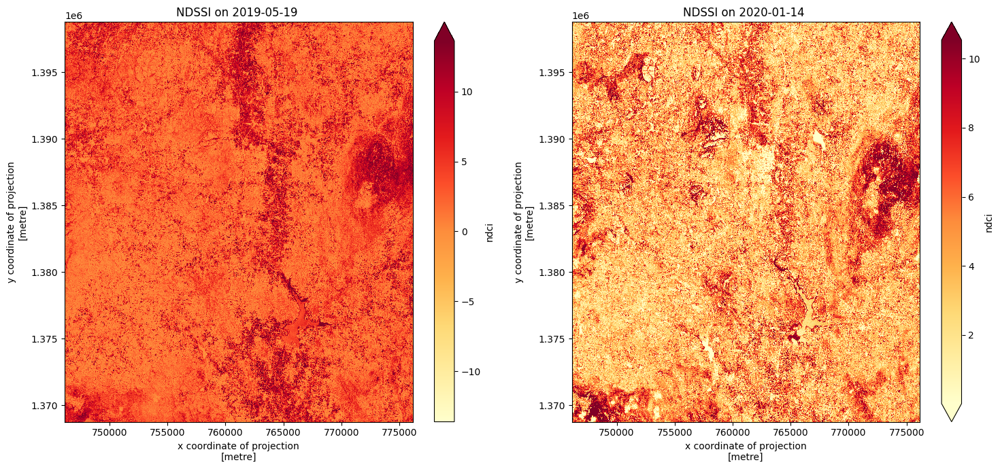

In [ ]:
fig, ax = plt.subplots(1, 2, figsize=(15, 7))
cliped['ndci'].sel(time='2019-05-19T05:25:42.000000000').plot(cmap='YlOrRd',ax=ax[0],robust=True)
cliped['ndci'].sel(time='2020-01-14T05:25:28.000000000').plot(cmap='YlOrRd',ax=ax[1],robust=True)
ax[0].set(title='NDSSI on 2019-05-19 ')
ax[1].set(title='NDSSI on 2020-01-14 ')
plt.tight_layout()